# Анализ тональности комментариев Youtube (Sentiment analysis)

## Загрузка необходимых библиотек

In [ ]:
!pip install selenium

In [ ]:
!pip install wordcloud

In [1554]:
import re
import time
from tqdm import tqdm
 
import numpy as np
import pandas as pd
 

import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from selenium import webdriver

import nltk
from nltk.corpus import stopwords as nltk_stopwords
from pymystem3 import Mystem
from wordcloud import WordCloud

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split

from sklearn.linear_model import LogisticRegression

from sklearn.metrics import *

## Парсинг текстов комментариев

In [75]:
#Зададим путь к основной папке
path_main = r"C:\Users\IvanovNikita"\
                      "\OneDrive - ООО «АЛЬМА Сервисез Компани»"\
                        "\Рабочий стол\data-utilitarian"\
                        "\Sentiment analysis"

In [11]:
#Зададим путь к папке с chromedriver
path_chrome_driver = r"C:\Users\IvanovNikita"\
                      "\OneDrive - ООО «АЛЬМА Сервисез Компани»"\
                        "\Рабочий стол\data-utilitarian"\
                        "\Sentiment analysis\chromedriver_win32"\
                        "\chromedriver.exe"

### Парсинг текстов комментариев видео 1

In [1164]:
webdriver.support.ui.WebDriverWait

selenium.webdriver.support.wait.WebDriverWait

In [1165]:
webdriver.support.wait.WebDriverWait()

selenium.webdriver.support.wait.WebDriverWait

In [1722]:
scrapped = []

with webdriver.Chrome(executable_path=path_chrome_driver) as driver:
    wait = webdriver.support.ui.WebDriverWait(driver,1)
    driver.get("https://www.youtube.com/watch?v=wCycCRk_Eak")

    for item in tqdm(range(200)): 
        wait.until(webdriver.support.expected_conditions.visibility_of_element_located(
            (By.TAG_NAME, "body"))).send_keys(webdriver.common.keys.Keys.END)
        time.sleep(2)

    for comment in wait.until(webdriver.support.expected_conditions.presence_of_all_elements_located(
        (By.CSS_SELECTOR, "#content"))):
        scrapped.append(comment.text)

C:\Users\IVANOV~1\AppData\Local\Temp/ipykernel_16072/3078193662.py:3: DeprecationWarning:

executable_path has been deprecated, please pass in a Service object

  6%|████▍                                                                            | 11/200 [00:37<10:49,  3.44s/it]


KeyboardInterrupt: 

In [27]:
len(scrapped)

1672

In [50]:
comments = [x.split('\nОТВЕТИТЬ')[0].split('\n')[1] for x in scrapped[0].split('назад')][1:]

In [59]:
len(scrapped[1:])

1671

In [67]:
comments_putin = comments + scrapped[1:]

In [70]:
for _ in range(10):

    print(comments_putin[np.random.randint(len(comments_putin))])

И звон курантов как погребальный колокол
Одно и тоже.
Бобра съел? Смотрю на этого клоуна в черном плаще, такое чувство что он на похорон пришел. Привет с Ростова
👎
Он щось забил про українських карателей )))
Всё ещё издевается над нами...
Фу фу фу как заучино, 
Ну пожалуйста, Владимир Владимирович, ну имейте совесть. Вы и так забрали за эту жизнь достаточно. Пожалуйста, уйдите с поста.
👎🏻👎🏻👎🏻
Решили экономические проблемы 😂


In [76]:
comments_putin_df = pd.DataFrame({'comment':comments_putin})

comments_putin_df.to_csv(path_main + '\\comments_putin.csv')

comments_putin_df

,comment
0,Народ тебя никогда не забудет
1,"Желаю путину всего того , что он сделал для на..."
2,"Зашёл сюда не послушать, а почитать! Сильно у..."
3,"2046 год. Путин: ""Год был непростым, прошу отн..."
4,"Я ждал что он скажет ""уходящий год был непрост..."
...,...
3339,Лучший президент России
3340,Благослови навеки Путина и Россию!
3341,В коментах вижувсе недовольные. Так идите рабо...
3342,Сами лучи президента России.


### Парсинг текстов комментариев видео 2

In [ ]:
scrapped = []

with webdriver.Chrome(executable_path=path_chrome_driver) as driver:
    wait = webdriver.support.ui.WebDriverWait(driver,1)
    driver.get("https://www.youtube.com/watch?v=Uy4aUXevKEE")

    for item in tqdm(range(200)): 
        wait.until(webdriver.support.expected_conditions.visibility_of_element_located(
            (By.TAG_NAME, "body"))).send_keys(webdriver.common.keys.Keys.END)
        time.sleep(2.5)

    for comment in wait.until(webdriver.support.expected_conditions.presence_of_all_elements_located(
        (By.CSS_SELECTOR, "#content"))):
        scrapped.append(comment.text)

In [78]:
len(scrapped)

598

In [100]:
comments = [x.split('\nОТВЕТИТЬ')[0].split('\n') for x in scrapped[0].split('назад')]

In [104]:
comments_1 = [x[1] for x in comments if len(x)>1 ][2:]

In [105]:
len(scrapped[1:])

597

In [106]:
comments_shulman = comments_1 + scrapped[1:]

In [112]:
len(comments_shulman)

2254

for _ in range(10):

    print(comments_shulman[np.random.randint(len(comments_shulman))])

In [114]:
comments_shulman_df = pd.DataFrame({'comment':comments_shulman})

comments_shulman_df.to_csv(path_main + '\\comments_shulman.csv')

comments_shulman_df

,comment
0,Новогоднее обращение которое приятно смотреть!...
1,"С Новым годом, Екатерина Михайловна!!! Вы - лу..."
2,"Невероятная умница Екатерина! Дарит крылья, си..."
3,"С Новым годом, уважаемая Екатерина Михайловна!..."
4,"В этом году я открыла для себя вас, Екатерина ..."
...,...
2249,Вам предстоит побороться с Алексеем Анатольеви...
2250,Екатерину Михайловну в президенты! Ура! У снов...
2251,Ну вот это я понимаю. Куда приятнее видеть так...
2252,С Новым годищщем! Это же будет интересный год)


## Загрузка размеченного датасета study.mokoron
Источник https://study.mokoron.com/

In [130]:
positive = pd.read_csv(path_main + '\\russian_sentiment_tweet_automated_labeled\\positive.csv',
                       sep = ';',
                       header= None
                      )

In [132]:
negative = pd.read_csv(path_main + '\\russian_sentiment_tweet_automated_labeled\\negative.csv',
                       sep = ';',
                       header= None
                      )

In [135]:
positive_text = pd.DataFrame(positive.iloc[:, 3])
negative_text = pd.DataFrame(negative.iloc[:, 3])

In [136]:
positive_text['label'] = [1] * positive_text.shape[0]
negative_text['label'] = [0] * negative_text.shape[0]

In [137]:
labeled_tweets = pd.concat([positive_text, negative_text])

In [139]:
labeled_tweets.index = range(labeled_tweets.shape[0])

In [143]:
labeled_tweets.columns = ['text', 'label']
labeled_tweets

,text,label
0,"@first_timee хоть я и школота, но поверь, у на...",1
1,"Да, все-таки он немного похож на него. Но мой ...",1
2,RT @KatiaCheh: Ну ты идиотка) я испугалась за ...,1
3,"RT @digger2912: ""Кто то в углу сидит и погибае...",1
4,@irina_dyshkant Вот что значит страшилка :D\nН...,1
...,...,...
226829,Но не каждый хочет что то исправлять:( http://...,0
226830,скучаю так :-( только @taaannyaaa вправляет мо...,0
226831,"Вот и в школу, в говно это идти уже надо(",0
226832,"RT @_Them__: @LisaBeroud Тауриэль, не грусти :...",0


### Очистка размеченного датасета

Напишем фукнцию для очистки текстов от лишних символов

In [181]:
# Оставим в тексте только кириллические символы
def clear_text(text):
    clear_text = re.sub(r'[^А-яЁё]+', ' ', text).lower()
    return " ".join(clear_text.split())
    

# напишем функцию удаляющую стоп-слова
def clean_stop_words(text, stopwords):
    text = [word for word in text.split() if word not in stopwords]
    return " ".join(text)

In [142]:
# загрузим список стоп-слов
stopwords = set(nltk_stopwords.words('russian'))
np.array(stopwords)

array({'если', 'ну', 'ней', 'была', 'этот', 'них', 'за', 'потому', 'лучше', 'над', 'мы', 'быть', 'какой', 'мой', 'иногда', 'моя', 'совсем', 'куда', 'уж', 'другой', 'были', 'уже', 'наконец', 'почти', 'с', 'ей', 'при', 'его', 'этом', 'тебя', 'к', 'было', 'меня', 'когда', 'ни', 'между', 'сейчас', 'им', 'него', 'где', 'или', 'много', 'же', 'после', 'три', 'конечно', 'разве', 'впрочем', 'зачем', 'эти', 'вам', 'ему', 'можно', 'нельзя', 'он', 'есть', 'всего', 'того', 'себе', 'перед', 'от', 'бы', 'кто', 'всю', 'ним', 'тоже', 'под', 'во', 'здесь', 'да', 'все', 'ли', 'тем', 'больше', 'как', 'а', 'нибудь', 'ведь', 'до', 'этой', 'по', 'я', 'тогда', 'ее', 'чего', 'мне', 'эту', 'опять', 'об', 'чем', 'но', 'такой', 'на', 'что', 'там', 'будет', 'ж', 'более', 'нас', 'том', 'всегда', 'может', 'у', 'она', 'ничего', 'тут', 'сам', 'никогда', 'только', 'в', 'тот', 'со', 'нее', 'так', 'всех', 'был', 'вы', 'чтобы', 'то', 'ты', 'хорошо', 'раз', 'какая', 'этого', 'еще', 'вдруг', 'их', 'и', 'один', 'про', 'потом

In [184]:
# Протестируем работу функции очистки текста
text = labeled_tweets['text'][np.random.randint(labeled_tweets.shape[0])]
print(text)
print('=======================================')
print(clean_stop_words((clear_text(text)), stopwords))

Говорю в нос... И капли не помогают(( Уже не знаю что сделать, чтоб эта фигня прошла
говорю нос капли помогают знаю сделать эта фигня прошла


In [185]:
start_clean = time.time()

labeled_tweets['text_clear'] = labeled_tweets['text']\
     c                           .apply(lambda x: clean_stop_words(clear_text(str(x)), stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 2.05 секунд


In [187]:
labeled_tweets = labeled_tweets[['text_clear', 'label']]
labeled_tweets

,text_clear,label
0,школота поверь самое общество профилирующий пр...,1
1,таки немного похож мальчик равно,1
2,идиотка испугалась,1
3,углу сидит погибает голода ещё порции взяли хо...,1
4,значит страшилка блин посмотрев части создастс...,1
...,...,...
226829,каждый хочет исправлять,0
226830,скучаю вправляет мозги равно скучаю,0
226831,школу говно это идти,0
226832,тауриэль грусти обнял,0


In [188]:
labeled_tweets.to_csv(path_main + '\\labeled_tweets_clean.csv')

## Загрузка размеченного датасета  Linis Crowd
Источник http://www.linis-crowd.org/

In [696]:
labeled_texts_1 = pd.read_excel(
    path_main + '\\linis_crowd_dataset\\doc_comment_summary.xlsx',
    sheet_name = 0,
    header=None
    )

In [1166]:
labeled_texts_1

,text,label
0,Но при мужчине ни одна приличная женщина не по...,-1.0
1,Украина это часть Руси искусственно отделенная...,-1.0
2,Как можно говорить об относительно небольшой к...,-1.0
3,1.2014. а что они со своими поляками сделали?...,0.0
4,у а фильмы... Зрители любят диковинное. у ме...,0.0
...,...,...
26868,Многих заставляют. Многие сами проявляют излиш...,-1.0
26869,Очередной Чубайс. ну а чего нового то? Сорос ...,-1.0
26870,"Закон, как все предыдущие - абсолютный бред и ...",0.0
26871,дело которое ты делаешь сейчас - оно очень хор...,0.0


In [698]:
labeled_texts_1['label'] = pd.to_numeric(labeled_texts_1.iloc[:, 1], errors='coerce')

In [699]:
labeled_texts_1 = labeled_texts_1[[0, 'label']]

In [700]:
labeled_texts_1.columns = ['text', 'label']

In [1167]:
labeled_texts_1.label.value_counts()

 0.0        13930
-1.0         9203
 1.0         1795
-2.0         1534
 2.0          365
 22158.0        2
 21887.0        1
 23523.0        1
 23486.0        1
Name: label, dtype: int64

In [1170]:
ind_drop = labeled_texts_1.query('label > 2 or label < - 2').index

ind_drop

Int64Index([10224, 15325, 15786, 17474, 26375], dtype='int64')

In [1171]:
labeled_texts_1 = labeled_texts_1.query('index not in @ind_drop')

In [1176]:
for _ in range(4):
    
    sample = labeled_texts_1.sample(n = 1)
    
    print('label: ', sample.label.values[0])
    
    print(sample['text'].values[0][:200]) 
    
    print()

label:  0.0
ам проблема - ДТ не может подступиться к этому светофору, чтоб пробку убрать. Он в ведении дирекции метро  Нафиг, нафиг такие нововведения !!! Вообще нехрен разгонять КП !!! Просто разведенку и всё!  

label:  -2.0
нг, В. Ресслер, граф Пален, граф Воронцов-Дашков, Соболевский. Н.Н. и т.д. и т.п. Так что - подучите матчасть.3.   Только из русских, не считая калмыков, татар, азербайджанцев, казаков, украинцев и пр

label:  0.0
ачата глубокая модернизация тяжелого атомного ракетного крейсера проекта 11442  Адмирал Нахимов ...После модернизации ракетный крейсер будет нести до 80 единиц ракетного оружия различного предназначен

label:  0.0
А как отметить?  Поздравляю ЦСКА с Юбилеем90 !Но даже сейчас нельзя обойтись без конструктивной критики Верховного главнокомандующего Армией...Открытое обращение-58 к В.Путину:3 уступки Путина опять з



In [1177]:
selected = labeled_texts_1.query('label != 0')

In [1179]:
selected.label.value_counts()

-1.0    9203
 1.0    1795
-2.0    1534
 2.0     365
Name: label, dtype: int64

In [1194]:
selected.loc[:, 'label_binary'] = np.nan

In [1195]:
selected.loc[((selected['label'] == -1) |
         (selected['label'] == -2)), 'label_binary'] = 0

C:\Users\IvanovNikita\miniconda3\lib\site-packages\pandas\core\indexing.py:1720: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [1200]:
selected.loc[((selected['label'] == 1) |
         (selected['label'] == 2)), 'label_binary'] = 1

C:\Users\IvanovNikita\miniconda3\lib\site-packages\pandas\core\indexing.py:1720: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [1201]:
selected.label_binary.value_counts()

0.0    10737
1.0     2160
Name: label_binary, dtype: int64

In [1213]:
for _ in range(3):
    
    sample_neg = selected.query('label_binary == 0').sample(n = 1)
    
    sample_pos = selected.query('label_binary == 1').sample(n = 1)
    
    print('label: ', sample_pos.label_binary.values[0])
    
    print(sample_pos['text'].values[0][:200]) 
    
    print('label: ', sample_neg.label_binary.values[0])
    
    print(sample_neg['text'].values[0][:200]) 
    
    print()

label:  1.0
И был удивлен, когда вдруг обнаружил, что цены-то там вполне доступны.  распродажа... фирменный магазин уже давно окупил партию и может себе позволить распродать всё по бросовой цене. Частник на рынке
label:  0.0
 какова статистика, кто из ДД адаптировался? в жизни? Сколько из них сам потом не отказался от своего ребенка и не обрек его на то же существование. Сколько из них получили высшее образование и работа

label:  1.0
А уж сколько я за свое вождение любителей липучки из кюветов вытаскивал и не передать :)    зато одна-единственная ледяная горка за всю зиму способна испортить вам здоровье и автомобиль надолго.Именно
label:  0.0
на нашей зоне и полугода хватит для полного осознания своей ничтожности и ненужности. Впрочем, можно и за один день ох.еть, проверено (не на зоне)  А вот не брали бы взяток, и отношение было бы другое

label:  1.0
стати, пишет-то их кто? В основном, женщины и пишут. Так получается, и правда,  сама дура! ?   как-то все мужики мудаками показались..

## Лемматизация текстов

In [1251]:
start_clean = time.time()

selected['text_clear'] = selected['text']\
                               .apply(lambda x:
                                      clean_stop_words(
                                        clear_text(str(x)),
                                        stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 1.42 секунд


C:\Users\IVANOV~1\AppData\Local\Temp/ipykernel_16072/1412772370.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [1275]:
def lemmatize(df : (pd.Series, pd.DataFrame),
              text_column : (None, str),
              n_samples : int,
              break_str = 'br',
             ) -> pd.Series:
    """
    Принимает:
    df -- таблицу или столбец pandas содержащий тексты,
    text_column -- название столбца указываем если передаем таблицу,
    n_samples -- количество текстов для объединения,
    break_str -- символ разделения, нужен для ускорения,
    количество текстов записанное в n_samples объединяется 
    в одит большой текст с предварительной вставкой символа 
    записанного в break_str между фрагментами
    затем большой текст лемматизируется, после чего разбивается на
    фрагменты по символу break_str
    
    
    Возвращает:
    Столбец pd.Series с лемматизированными текстами
    в которых все слова приведены к изначальной форме:
    * для существительных — именительный падеж, единственное число;
    * для прилагательных — именительный падеж, единственное число,
    мужской род;
    * для глаголов, причастий, деепричастий — глагол в инфинитиве 
    (неопределённой форме) несовершенного вида.
    
    """
    
    result = []
    
    m = Mystem()    
    
    for i in tqdm(range((df.shape[0] // n_samples) + 1)) :
        
        start = i * n_samples
        
        stop = start + n_samples
        
        sample = break_str.join(df[text_column][start : stop].values)
        
        lemmas = m.lemmatize(sample)
        
        lemm_sample = ''.join(lemmas).split(break_str)
        
        result += lemm_sample
        
    return pd.Series(result, index = df.index)

In [1262]:
selected['lemm_clean_tex'] = lemmatize(
    df = selected,
    text_column = 'text_clear',
    n_samples = 100,
    break_str = 'br',
    )

100%|████████████████████████████████████████████████████████████████████████████████| 130/130 [02:46<00:00,  1.28s/it]


In [1271]:
selected.head()

,text,label,label_binary,text_clear,lemm_clean_tex
0,Но при мужчине ни одна приличная женщина не по...,-1.0,0.0,мужчине одна приличная женщина пойдет лазить р...,мужчина один приличный женщина пойти лазить ра...
1,Украина это часть Руси искусственно отделенная...,-1.0,0.0,украина это часть руси искусственно отделенная...,украина это часть русь искусственно отделять к...
2,Как можно говорить об относительно небольшой к...,-1.0,0.0,говорить относительно небольшой коррупции обра...,говорить относительно небольшой коррупция обра...
5,Государство не может сейчас платить больше и м...,-1.0,0.0,государство платить посмотрите денежный поток ...,государство платить посмотреть денежный поток ...
8,эксплуатируемые способны только на бунты - бес...,-1.0,0.0,эксплуатируемые способны бунты бессмысленные б...,эксплуатируемые способный бунт бессмысленный б...


In [1273]:
labeled_tweets['lemm_text_clear'] = lemmatize(
    df = labeled_tweets,
    text_column = 'text_clear',
    n_samples = 1000,
    break_str = 'br',
    )

100%|████████████████████████████████████████████████████████████████████████████████| 227/227 [04:14<00:00,  1.12s/it]


In [1276]:
labeled_tweets

,text_clear,label,lemm_text_clear
0,школота поверь самое общество профилирующий пр...,1,школоть поверять самый общество профилировать ...
1,таки немного похож мальчик равно,1,таки немного похожий мальчик равно
2,идиотка испугалась,1,идиотка испугалась
3,углу сидит погибает голода ещё порции взяли хо...,1,углу сидеть погибать голод еще порция взять хо...
4,значит страшилка блин посмотрев части создастс...,1,значит страшилка блин посмотреть часть создава...
...,...,...,...
226829,каждый хочет исправлять,0,каждый хотеть исправлять
226830,скучаю вправляет мозги равно скучаю,0,скучаю вправлять мозги равный скучаю
226831,школу говно это идти,0,школу гавно это идти
226832,тауриэль грусти обнял,0,тауриэль грусть обнял


## Объединение двух наборов текстов

In [1377]:
sample_1 = labeled_tweets[['text_clear', 'lemm_text_clear', 'label']]

sample_2 = selected[['text_clear', 'lemm_clean_tex', 'label_binary']]

In [1378]:
sample_2.columns = ['text_clear','lemm_text_clear', 'label']

In [1632]:
sample_2.isna().sum()

text_clear          0
lemm_text_clear     0
label              41
dtype: int64

In [1633]:
sample_2 = sample_2.dropna()
sample_2.isna().sum()

text_clear         0
lemm_text_clear    0
label              0
dtype: int64

In [1379]:
joned_text = pd.concat([sample_1, sample_2])

In [1499]:
joned_text

,text,lemm_text,label
0,школота поверь самое общество профилирующий пр...,школоть поверять самый общество профилировать ...,1.0
1,таки немного похож мальчик равно,таки немного похожий мальчик равно,1.0
2,идиотка испугалась,идиотка испугалась,1.0
3,углу сидит погибает голода ещё порции взяли хо...,углу сидеть погибать голод еще порция взять хо...,1.0
4,значит страшилка блин посмотрев части создастс...,значит страшилка блин посмотреть часть создава...,1.0
...,...,...,...
239767,великое испытание выпало долю наших предков ве...,великое испытание выпадать доля наш предок веч...,1.0
239768,н своему поведению крайне низкий человек прост...,н свой поведение крайне низкий человек прощать...,0.0
239769,многие психологические книги кричат женщины да...,многие психологический книга кричать женщина д...,1.0
239770,многих заставляют многие сами проявляют излишн...,многих заставлять многий сам проявлять излишни...,0.0


In [1381]:
joned_text.label.value_counts()

0.0    122660
1.0    117071
Name: label, dtype: int64

In [1383]:
joned_text.columns = ['text', 'lemm_text', 'label']

In [1384]:
joned_text.index = range(joned_text.shape[0])

In [1385]:
joned_text.isna().sum()

text          0
lemm_text     0
label        41
dtype: int64

In [1386]:
joned_text = joned_text.dropna()
joned_text.isna().sum()

text         0
lemm_text    0
label        0
dtype: int64

## Получение TF-IDF векторных представлений размеченных текстов

Для обучения классификатора получим значения IDF (inference document frequency) для слов из тренировочного набора данных, значения IDF равны логарифму отношения количества документов к количеству документов содержащих искомое слово. Например для стандартных слов, которые встречаются практически в любом тексте IDF будет близок к единице, а для специфичных, которые встречаются в одном тексте из 100 это значение будет равно уже 2 (если мы берем основание логарифма 10).

Затем получив словарь со значениями IDF мы можем получить векторное представление каждого текста по следующему принципу, значения IDF слова умножаем на значения

In [1636]:
sample_2.columns = ['text', 'text_lemm', 'label']

In [1659]:
sample_1.columns = ['text', 'text_lemm', 'label']

In [1661]:
# предварительно разделим выборку на тестовую и обучающую
train, test = train_test_split(sample_1,
                        test_size = 0.2,
                        random_state = 12348,
                       )

print(train.shape)
print(test.shape)

(181467, 3)
(45367, 3)


In [1662]:
train

,text,text_lemm,label
162424,учёные заметили кредитных договорах самом низу...,учёные замечать кредитный договор самый низ ст...,0
160594,капец голова болит заболел походу работу ехать,капец голова болеть заболевать поход работа ехать,0
189688,взяла твиттер удалила,взяла твиттер удалила,0
78348,оно понятно определилась,оно понятный определилась,1
157114,уроки нужно сделать контре подготовиться,уроки нужно сделать контра подготовиться,0
...,...,...,...
141717,кажется начинаю остывать это очень ху холодно,кажется начинать остывать это очень ху холодно,0
207453,дорогой дело твое просто очень грустно преврат...,дорогой дело твой просто очень грустно превращ...,0
36863,председатель правительства рф дмитрий медведев...,председатель правительство рф дмитрий медведев...,1
146555,аххаха баба фрося аххахаха глуши нить,аххаха баба фрося аххахах глушь нить,0


In [1663]:
# Сравним распределение целевого признака
for sample in [train, test]:    
    print(sample[sample['label'] == 1].shape[0] / sample.shape[0])

0.5066265491797407
0.5064253752727753


In [1664]:
count_idf_positive = TfidfVectorizer(ngram_range = (1,1))
count_idf_negative = TfidfVectorizer(ngram_range = (1,1))

tf_idf_positive = count_idf_positive.fit_transform(train.query('label == 1')['text'])
tf_idf_negative = count_idf_negative.fit_transform(train.query('label == 0')['text'])

In [1665]:
# Сохраним списки Idf для каждого класса
positive_importance = pd.DataFrame(
    {'word' : count_idf_positive.get_feature_names_out(),
     'idf' : count_idf_positive.idf_
    }).sort_values(by = 'idf', ascending = False)

negative_importance = pd.DataFrame(
    {'word' : count_idf_negative.get_feature_names_out(),
     'idf' : count_idf_negative.idf_
    }).sort_values(by = 'idf', ascending = False)

In [1666]:
positive_importance.query('word not in @negative_importance.word and idf < 10.8')

,word,idf
34257,клал,10.637099
56843,отпуском,10.637099
57541,охрененный,10.637099
55852,ответныйфолловинг,10.637099
56045,отдельную,10.637099
...,...,...
70829,продолжай,9.209983
93370,улыбнуло,8.667659
53367,оглядываются,8.557658
73605,разблокируют,8.537039


In [1667]:
negative_importance.query('word not in @positive_importance.word and idf < 10')

,word,idf
30801,красноярцы,9.917445
8270,взорвалась,9.917445
40278,начаться,9.917445
74891,терактов,9.917445
58453,прискорбно,9.917445
...,...,...
68023,скорбим,8.595689
52192,погибших,8.395018
41110,некролог,8.359300
74888,теракт,8.308007


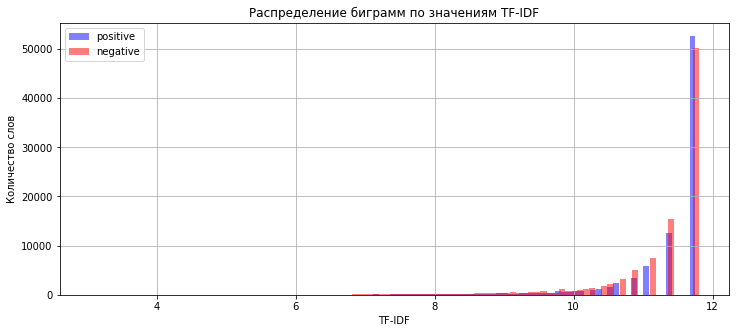

In [1298]:
fig = plt.figure(figsize = (12,5))
positive_importance.idf.hist(bins = 100,
                             label = 'positive',
                             alpha = 0.5,
                             color = 'b',
                            )
negative_importance.idf.hist(bins = 100,
                             label = 'negative',
                             alpha = 0.5,
                             color = 'r',
                            )
plt.title('Распределение биграмм по значениям TF-IDF')
plt.xlabel('TF-IDF')
plt.ylabel('Количество слов')
plt.legend()
plt.show()

## Предварительное обучение моделей

In [1668]:
# Получим векторные представления текстов
count_idf_1 = TfidfVectorizer(ngram_range=(1,1))

In [1669]:
tf_idf_base_1 = count_idf_1.fit(sample_1['text'])
tf_idf_train_base_1 = count_idf_1.transform(train['text'])
tf_idf_test_base_1 = count_idf_1.transform(test['text'])

In [1670]:
display(tf_idf_test_base_1.shape)
display(tf_idf_train_base_1.shape)

(45367, 170344)

(181467, 170344)

In [1671]:
model_lr_base_1 = LogisticRegression(solver = 'lbfgs',
                                    random_state = 12345,
                                    max_iter= 10000,
                                    n_jobs= -1)

Получим прогноз и оценим качество модели

In [1672]:
model_lr_base_1.fit(tf_idf_train_base_1, train['label'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=12345)

In [1673]:
predict_lr_base_proba = model_lr_base_1.predict_proba(tf_idf_test_base_1)

### Сравнение качества классификации на лемматизированных текстах

In [1674]:
# Получим векторные представления лемматизированных текстов
count_idf_lemm = TfidfVectorizer(ngram_range=(1,1))

In [1675]:
tf_idf_lemm = count_idf_lemm.fit(sample_1['text_lemm'])
tf_idf_train_lemm = count_idf_lemm.transform(train['text_lemm'])
tf_idf_test_lemm = count_idf_lemm.transform(test['text_lemm'])

In [1676]:
display(tf_idf_train_lemm.shape)
display(tf_idf_test_lemm.shape)

(181467, 134455)

(45367, 134455)

In [1677]:
model_lr_lemm = LogisticRegression(solver = 'lbfgs',
                                    random_state = 12345,
                                    max_iter= 10000,
                                    n_jobs= -1)

Получим прогноз и оценим качество модели

In [1678]:
model_lr_lemm.fit(tf_idf_train_lemm, train['label'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=12345)

In [1679]:
predict_lr_lemm_proba = model_lr_lemm.predict_proba(tf_idf_test_lemm)

В качестве сравнения сделаем классификатор который в качестве прогноза выдает случайное число в интервале от 0 до 1 

In [1680]:
def coin_classifier(X:np.array) -> np.array:
    predict = np.random.uniform(0.0, 1.0, X.shape[0])
    return predict

In [1681]:
coin_predict = coin_classifier(tf_idf_test_base_1)

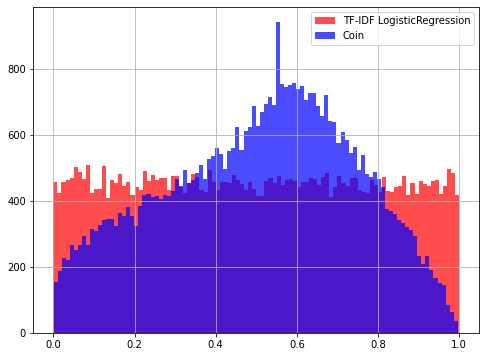

In [1682]:
fif = plt.figure(figsize = (8, 6))

pd.Series(coin_predict)\
                .hist(bins = 100,
                      alpha = 0.7,
                      color = 'r',
                      label = 'TF-IDF LogisticRegression'
                     )

pd.Series(predict_lr_base_proba[:, 1])\
                .hist(bins = 100,
                      alpha = 0.7,
                      color = 'b',
                      label = 'Coin'
                     )
plt.legend()   
plt.show()

### Визуализация ROC-кривых классификаторов

In [1683]:
fpr_base, tpr_base, _ = roc_curve(test['label'], predict_lr_base_proba[:, 1])
roc_auc_base = auc(fpr_base, tpr_base)

In [1684]:
fpr_lemm, tpr_lemm, _ = roc_curve(test['label'], predict_lr_lemm_proba[:, 1])
roc_auc_lemm = auc(fpr_lemm, tpr_lemm)

In [1685]:
fpr_coin, tpr_coin, _ = roc_curve(test['label'], coin_predict)
roc_auc_coin = auc(fpr_base, tpr_base)

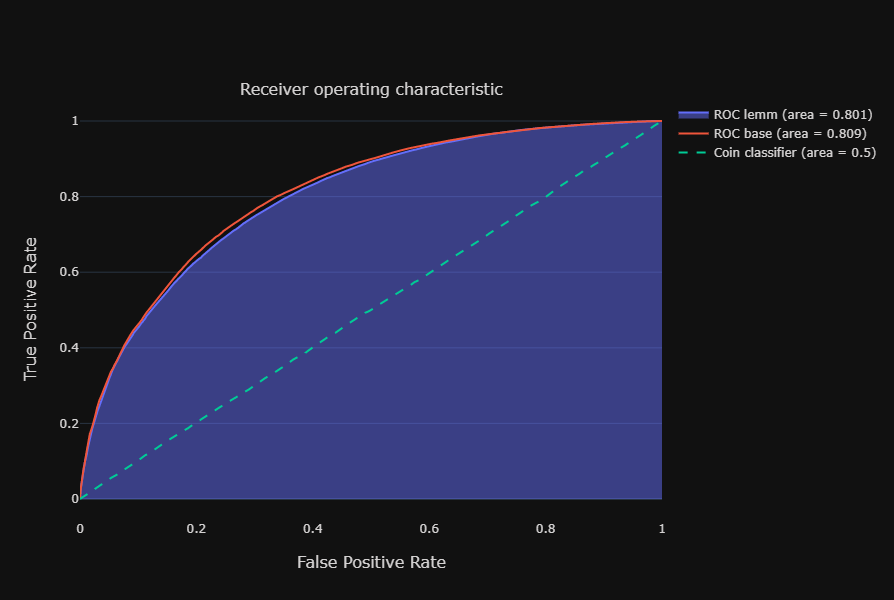

In [1686]:
fig = make_subplots(1,1,
                    subplot_titles = ["Receiver operating characteristic"],
                    x_title="False Positive Rate",
                    y_title = "True Positive Rate"
                   )

fig.add_trace(go.Scatter(
    x = fpr_lemm,
    y = tpr_lemm,
    fill = 'tozeroy',
    name = "ROC lemm (area = %0.3f)" % roc_auc_lemm,
    ))

fig.add_trace(go.Scatter(
    x = fpr_base,
    y = tpr_base,
    #fill = 'tozeroy',
    name = "ROC base (area = %0.3f)" % roc_auc_base,
    ))

fig.add_trace(go.Scatter(
    x = fpr_coin,
    y = tpr_coin,
    mode = 'lines',
    line = dict(dash = 'dash'),
    name = 'Coin classifier (area = 0.5)'
    ))


fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    )

In [1687]:
# Выведем матрицы ошибок
confusion_matrix(test['label'],
                 (predict_lr_base_proba[:, 1] > 0.5).astype('float'),
                 normalize='true',
                )

array([[0.69087174, 0.30912826],
       [0.22611534, 0.77388466]])

In [1688]:
# Выведем матрицу ошибок
confusion_matrix(test['label'],
                 (predict_lr_lemm_proba[:, 1] > 0.5).astype('float'),
                 normalize='true',
                )

array([[0.68569132, 0.31430868],
       [0.23847661, 0.76152339]])

### Визуализация важности признаков

In [1689]:
# Получим веса признаков, то есть множители 
# подобранные логистической регрессией 
# для каждого компонента вектора tf-idf

weights = pd.DataFrame({'words': count_idf_1.get_feature_names_out(),
                        'weights': model_lr_base_1.coef_.flatten()})
weights_min = weights.sort_values(by= 'weights')
weights_max = weights.sort_values(by= 'weights', ascending = False)

In [1690]:
weights_min = weights_min[:100]
weights_min['weights'] = weights_min['weights'] * -1
weights_min

,words,weights
85419,обидно,6.913106
28964,грустно,6.084369
39067,жаль,6.079557
98823,печально,5.833982
132462,скучаю,5.404336
...,...,...
165003,шерлок,2.627264
150793,уехала,2.616249
27141,голова,2.614375
131999,скорбим,2.602911


In [1691]:
weights_max = weights_max[:100]
weights_max

,words,weights
5503,ахаха,4.534308
5502,ахах,4.350795
86118,обожаю,4.257825
20898,вромайдан,4.250786
5539,ахахах,4.214949
...,...,...
123673,рекомендую,2.029362
152732,ураааа,2.025815
67727,майдан,2.022085
134420,снов,2.014393


In [1692]:
# Воспользуемся библиотекой wordcloud для генерации картинок

wordcloud_positive = WordCloud(background_color="white",
                               colormap = 'Blues',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(weights_max.values))

wordcloud_negative = WordCloud(background_color="black",
                               colormap = 'Reds',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(weights_min.values))

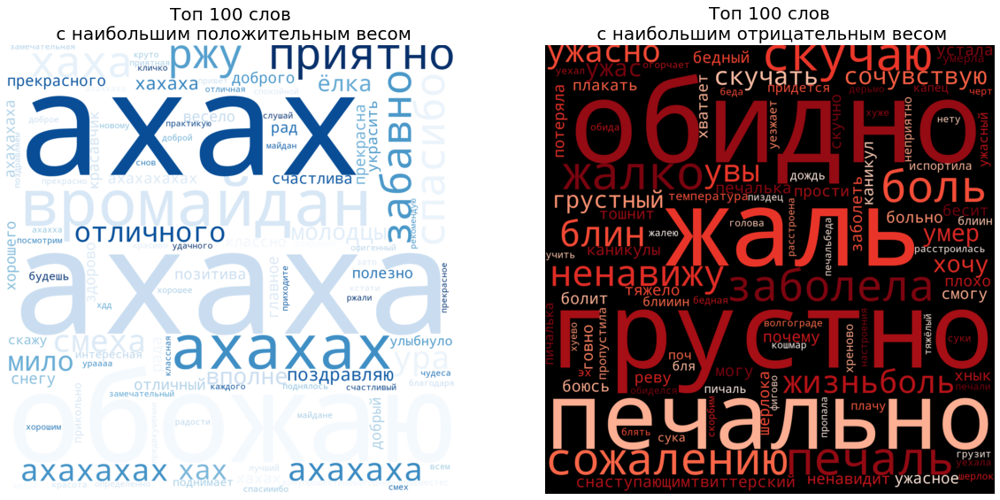

In [1693]:
# Выведем картинки сгенерированные вордклаудом
fig, ax = plt.subplots(1, 2, figsize = (20, 12))


ax[0].imshow(wordcloud_positive, interpolation='bilinear')
ax[1].imshow(wordcloud_negative, interpolation='bilinear')

ax[0].set_title('Топ ' +\
                str(weights_max.shape[0]) +\
                ' слов\n с наибольшим положительным весом',
               fontsize = 20
               )
ax[1].set_title('Топ ' +\
                str(weights_min.shape[0]) +\
                ' слов\n с наибольшим отрицательным весом',
               fontsize = 20
               )

ax[0].axis("off")
ax[1].axis("off")

plt.show()

### Снижение размерности признакового пространства модели

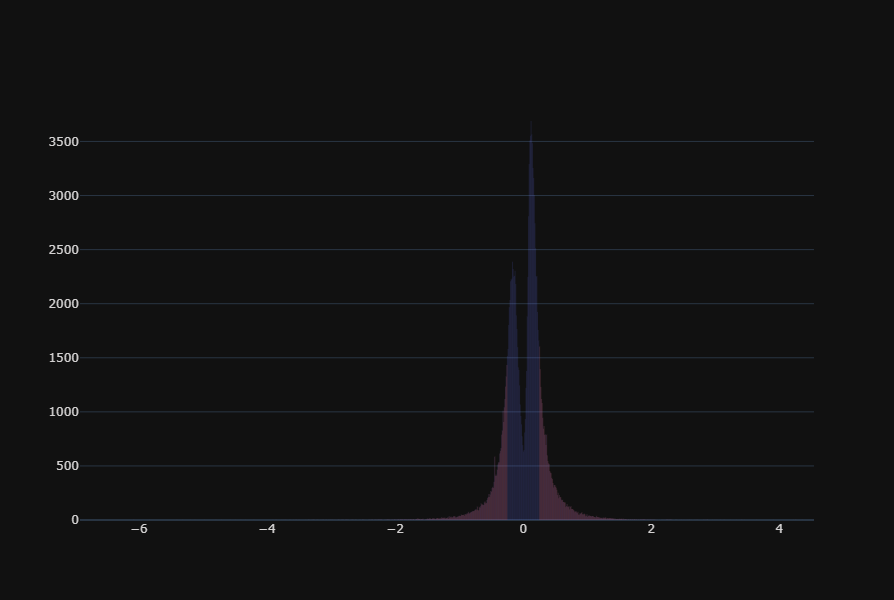

In [1694]:
fig = make_subplots(1,1)

fig.add_trace(go.Histogram(
    x = weights.query('weights != 0')['weights'],
    #histnorm = 'probability',
    opacity = 0.5,
    showlegend = False
))

fig.add_trace(go.Histogram(
    x = weights.query('weights > 0.25 or weights < -0.25')['weights'],
    #histnorm = 'probability',
    opacity = 0.5,
    showlegend = False
))

fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    
)

In [1695]:
vocab = weights.query('weights > 0.25 or weights < -0.25')['words']

In [1696]:
vocab

1                ааа
2               аааа
3              ааааа
4             аааааа
5            ааааааа
             ...    
170334     ёёлочкууу
170335        ёёпрст
170339    ёёёлочкааа
170340          ёёёё
170342        ёёёёёё
Name: words, Length: 48832, dtype: object

Получим векторные представления текстов

In [1697]:
count_idf = TfidfVectorizer(vocabulary=vocab,
                            ngram_range=(1,1))

In [1698]:
tf_idf = count_idf.fit_transform(joned_text['text'])

tf_idf_train = count_idf.transform(train['text'])
tf_idf_test = count_idf.transform(test['text'])

In [1699]:
display(tf_idf_test.shape)
display(tf_idf_train.shape)

(45367, 48832)

(181467, 48832)

In [1700]:
model_lr_base = LogisticRegression(solver = 'lbfgs',
                                    random_state = 12345,
                                    max_iter= 10000,
                                    n_jobs= -1)

Получим прогноз и оценим качество модели

In [1701]:
model_lr_base.fit(tf_idf_train, train['label'])

LogisticRegression(max_iter=10000, n_jobs=-1, random_state=12345)

In [1702]:
predict_lr_base_proba_1 = model_lr_base.predict_proba(tf_idf_test)

In [1703]:
fpr_base_1, tpr_base_1, _ = roc_curve(test['label'], predict_lr_base_proba_1[:, 1])
roc_auc_base_1 = auc(fpr_base_1, tpr_base_1)

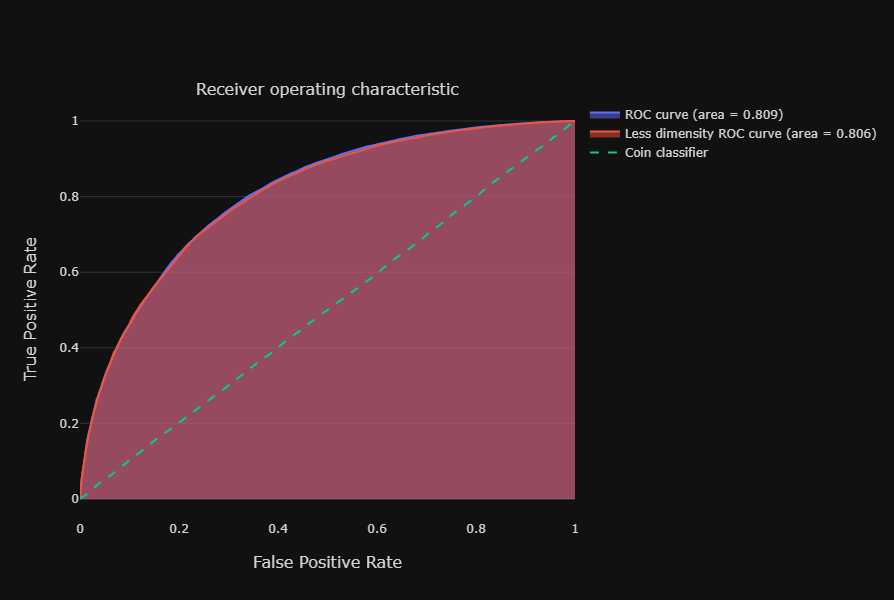

In [1704]:
fig = make_subplots(1,1,
                    subplot_titles = ["Receiver operating characteristic"],
                    x_title="False Positive Rate",
                    y_title = "True Positive Rate"
                   )

fig.add_trace(go.Scatter(
    x = fpr_base,
    y = tpr_base,
    fill = 'tozeroy',
    name = "ROC curve (area = %0.3f)" % roc_auc_base,
    ))

fig.add_trace(go.Scatter(
    x = fpr_base_1,
    y = tpr_base_1,
    fill = 'tozeroy',
    name = "Less dimensity ROC curve (area = %0.3f)" % roc_auc_base_1,
    ))

fig.add_trace(go.Scatter(
    x = fpr_coin,
    y = tpr_coin,
    mode = 'lines',
    line = dict(dash = 'dash'),
    name = 'Coin classifier'
    ))


fig.update_layout(
    height = 600,
    width = 800,
    xaxis_showgrid=False,
    xaxis_zeroline=False,
    template = 'plotly_dark',
    font_color = 'rgba(212, 210, 210, 1)'
    )

Вывод:

Мы снизили размерность векторов tf-idf потеряв при этом 0.3% качества (площадь под ROC кривой при размерности > 170К 0.809, площадь под ROC кривой при размерности > 48K -- 0.806)

### Подбор оптимального порогового значения классификации

In [1705]:
scores = {}

weight = 0.55

for threshold in np.linspace(0, 1, 100):
    
    matrix = confusion_matrix(test['label'],
                 (predict_lr_base_proba[:, 0] <  threshold).astype('float'),
                 normalize='true',
                )

    score = matrix[0,0] * weight + matrix[1,1] * (1 - weight)
    
    scores[threshold] = score

In [1706]:
pd.DataFrame({'true_score':scores.values(),
             'threshold':scores.keys()},
             ).sort_values(by = 'true_score', ascending = False).head()

,true_score,threshold
44,0.733457,0.444444
45,0.733021,0.454545
46,0.732878,0.464646
43,0.732444,0.434343
47,0.731603,0.474747


In [1707]:
matrix = confusion_matrix(test['label'],
                 (predict_lr_base_proba[:, 0] <  0.444444).astype('int'),
                 normalize='true',
                )
matrix

array([[0.77630404, 0.22369596],
       [0.31891186, 0.68108814]])

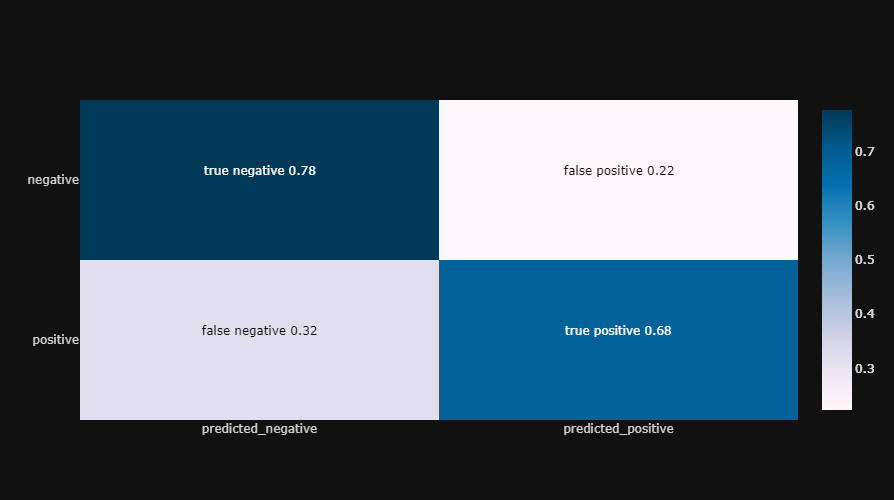

In [1708]:
# Сделаем красивый график матрицы ошибок

fig = make_subplots(1,1)

fig.add_trace(go.Heatmap(
     y = [ 'positive', 'negative'],
     x = ['predicted_negative', 'predicted_positive'],
     z = [matrix[1, :], matrix[0, :]],
     colorscale = 'PuBu'
))

fig.add_trace(go.Heatmap(
     y = [ 'positive', 'negative'],
     x = ['predicted_negative', 'predicted_positive'],
     z = [matrix[1, :], matrix[0, :]],
     colorscale = 'PuBu'
))

fig.add_annotation(x=0, y=0,
            text = "false negative " + str(round(matrix[1,0], 2)),
            showarrow=False,
            font = dict(color = 'black'),
            yshift=10)

fig.add_annotation(x=1, y=1,
            text = "false positive " + str(round(matrix[0,1], 2)),
            showarrow=False,
            font = dict(color = 'black'),
            yshift=10)

fig.add_annotation(x=1, y=0,
            text = "true positive " + str(round(matrix[1,1], 2)),
            showarrow=False,
            font = dict(color = 'white'),
            yshift=10)

fig.add_annotation(x=0, y=1,
            text = "true negative " + str(round(matrix[0,0], 2)),
            showarrow=False,
            font = dict(color = 'white'),
            yshift=10)


fig.update_layout(height = 500,
                  width = 500,
                  template = 'plotly_dark',
                  font_color = 'rgba(212, 210, 210, 1)',
                 ).show()

## Классификация не размеченных комментариев

C помощью обученных tf-idf векторизатора и логистической регрессии получим оценки вероятности негатива в каждом из комментариев

In [720]:
# очистим тексты комментариев под первым видео
start_clean = time.time()

comments_putin_df['text_clear'] = comments_putin_df['comment']\
                                .apply(lambda x: clean_stop_words(clear_text(str(x)), stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 0.03 секунд


In [721]:
# очистим тексты омментариев под вторым видео
start_clean = time.time()

comments_shulman_df['text_clear'] = comments_shulman_df['comment']\
                                .apply(lambda x: clean_stop_words(clear_text(str(x)), stopwords))

print('Обработка текстов заняла: '+str(round(time.time() - start_clean, 2))+' секунд')

Обработка текстов заняла: 0.03 секунд


### Визуализация ключевых слов

In [1555]:
shulman_counter = CountVectorizer(ngram_range=(1, 1))
putin_counter = CountVectorizer(ngram_range=(1, 1))

In [1569]:
shulman_count = shulman_counter.fit_transform(comments_shulman_df['text_clear'])
putin_count = putin_counter.fit_transform(comments_putin_df['text_clear'])

In [1578]:
shulman_count.toarray().sum(axis = 0).shape

(3673,)

In [1580]:
shulman_counter.get_feature_names_out().shape

(3673,)

In [1581]:
# Сохраним списки Idf для каждого класса
shulman_frequence = pd.DataFrame(
    {'word' : shulman_counter.get_feature_names_out(),
     'frequency' : shulman_count.toarray().sum(axis = 0)
    }).sort_values(by = 'frequency', ascending = False)

putin_frequence = pd.DataFrame(
    {'word' : putin_counter.get_feature_names_out(),
     'frequency' : putin_count.toarray().sum(axis = 0)
    }).sort_values(by = 'frequency', ascending = False)

display(shulman_frequence.shape[0])
display(putin_frequence.shape[0])

3673

5238

In [1587]:
putin_frequence = putin_frequence.query('word not in @shulman_importance.word')[:100]

In [1588]:
shulman_frequence = shulman_frequence.query('word not in @putin_frequence.word')[:100]

In [1599]:
# Воспользуемся библиотекой wordcloud для генерации картинок

wordcloud_shulman = WordCloud(background_color="black",
                               colormap = 'Blues',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(putin_frequence.values))

wordcloud_putin = WordCloud(background_color="black",
                               colormap = 'Oranges',
                               max_words=200,
                               mask=None, 
                                width=1600,
                               height=1600)\
                        .generate_from_frequencies(
                            dict(shulman_frequence.values))

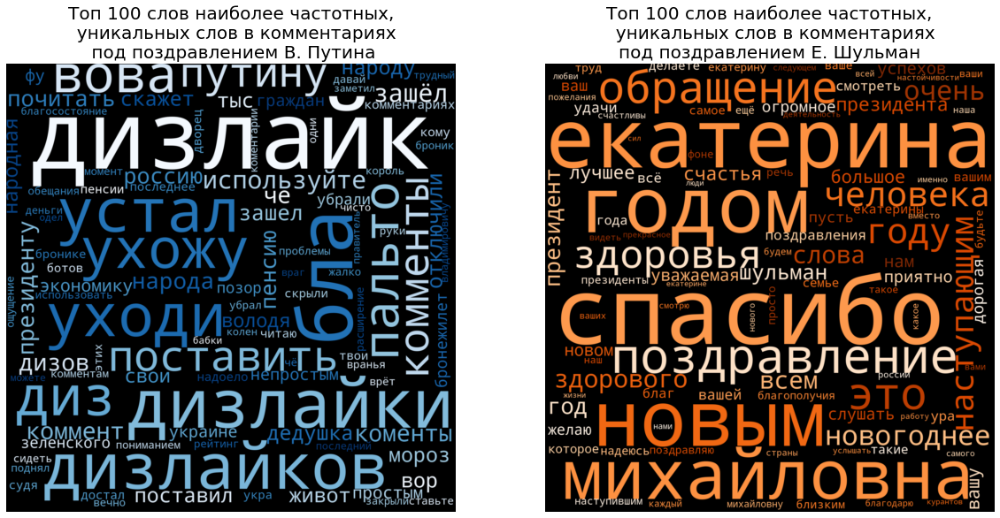

In [1709]:
# Выведем картинки сгенерированные вордклаудом
fig, ax = plt.subplots(1, 2, figsize = (20, 12))


ax[0].imshow(wordcloud_shulman, interpolation='bilinear')
ax[1].imshow(wordcloud_putin, interpolation='bilinear')

ax[0].set_title('Топ ' +\
                str(shulman_frequence.shape[0]) +\
                ' слов наиболее частотных,\n ' +\
                ' уникальных слов в комментариях\n' +\
                ' под поздравлением В. Путина',
               fontsize = 20
               )
ax[1].set_title('Топ ' +\
                str(putin_frequence.shape[0]) +\
                ' слов наиболее частотных,\n ' +\
                ' уникальных слов в комментариях\n' +\
                'под поздравлением Е. Шульман',
               fontsize = 20
               )

ax[0].axis("off")
ax[1].axis("off")

plt.show()

## Получение оценки негативности комментария

In [1714]:
# Выведем 5 случайных комментариев c оценкой негатива первого видео
for _ in range(5):

    source = comments_putin_df.sample(n=1)
    text_clear = source['text_clear'].values[0]
    text = source['comment'].values[0]

    print(text)

    tf_idf_text = count_idf.transform([text_clear])

    toxic_proba = model_lr_base.predict_proba(tf_idf_text)

    print('Вероятность негатива: ', toxic_proba[:, 0])
    print()

Из глубин космоса, с другой планеты....
Вероятность негатива:  [0.17425435]

Люди которые что-то пишут про Путина, просто не жили в Украине. Настолько мерзкое поздравление у Зели тупого
Вероятность негатива:  [0.26907868]

Ну пожалуйста, Владимир Владимирович, ну имейте совесть. Вы и так забрали за эту жизнь достаточно. Пожалуйста, уйдите с поста.
Вероятность негатива:  [0.7586992]

Не о чём. надоел за 20 лет.
Вероятность негатива:  [0.44267764]

Как же надоело лицезреть  брехующую рожу в телевизоре. Еле сдериваешься чтоб не плюнуть.
Вероятность негатива:  [0.50663857]



In [1712]:
# Выведем 5 случайных комментариев c оценкой негатива второго видео
for _ in range(5):

    source = comments_shulman_df.sample(n=1)
    text_clear = source['text_clear'].values[0]
    text = source['comment'].values[0]

    print(text)

    tf_idf_text = count_idf.transform([text_clear])

    toxic_proba = model_lr_base.predict_proba(tf_idf_text)

    print('Вероятность негатива: ', toxic_proba[:, 0])
    print()

Слушала вместо президента. Надеюсь, это хороший знак. С новым годом!
Вероятность негатива:  [0.28332684]

Поздравляю с наступающим новым новым! Пусть каждый идёт к своей цели. Или хотя бы лежит в её направлении
Вероятность негатива:  [0.13260609]

Екатерина Михайловна, снимаю шляпу! Спасибо и с Новым Годом!
Вероятность негатива:  [0.51244829]

Вот она, правильная речь президентки страны!
Вероятность негатива:  [0.16996972]

спасибо,вы важны!
Вероятность негатива:  [0.03899169]



In [1715]:
# Получим оценки негатива для всех комментариев первого и второго видео

putin_tf_idf = count_idf.transform(comments_putin_df['text_clear'])
shulman_tf_idf = count_idf.transform(comments_shulman_df['text_clear'])

putin_negative_proba = model_lr_base.predict_proba(putin_tf_idf)
shulman_negative_proba = model_lr_base.predict_proba(shulman_tf_idf)

comments_putin_df['negative_proba'] = putin_negative_proba[:, 0]
comments_shulman_df['negative_proba'] = shulman_negative_proba[:, 0]

Найдем доли негативных комментариев при оптимальном пороговом значении

In [1717]:
putin_share_neg = (comments_putin_df['negative_proba'] > 0.44).sum() / comments_putin_df.shape[0]
putin_share_neg

0.5493421052631579

In [1718]:
shulman_share_neg = (comments_shulman_df['negative_proba'] > 0.44).sum() / comments_shulman_df.shape[0]
shulman_share_neg

0.3234250221827862

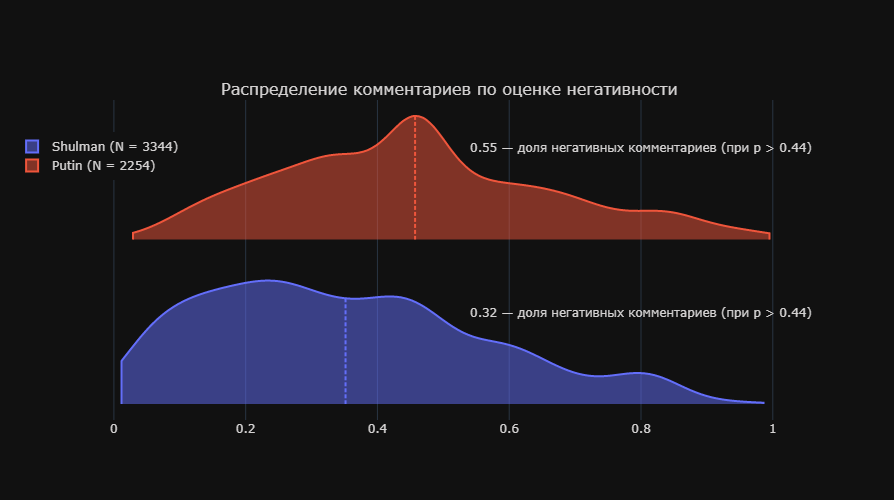

In [1721]:
fig = make_subplots(1,1,
                   subplot_titles=['Распределение комментариев по оценке негативности']     
                   )

fig.add_trace(go.Violin(
    x = comments_shulman_df['negative_proba'],
    meanline_visible = True,
    name = 'Shulman (N = %i)' % comments_putin_df.shape[0],
    side = 'positive',
    spanmode = 'hard'
))



fig.add_trace(go.Violin(
    x = comments_putin_df['negative_proba'],
    meanline_visible = True,
    name = 'Putin (N = %i)' % comments_shulman_df.shape[0],
    side = 'positive',
    spanmode = 'hard'
))


fig.add_annotation(x=0.8, y=1.5,
            text = "%0.2f — доля негативных комментариев (при p > 0.44)"\
                   % putin_share_neg,
            showarrow=False,
            yshift=10)

fig.add_annotation(x=0.8, y=0.5,
            text = "%0.2f — доля негативных комментариев (при p > 0.44)"\
                   % shulman_share_neg,
            showarrow=False,
            yshift=10)

fig.update_traces(orientation='h', 
                  width = 1.5,
                  points = False
                 )


fig.update_layout(height = 500,
                  #xaxis_showgrid=False,
                  xaxis_zeroline=False,
                  template = 'plotly_dark',
                  font_color = 'rgba(212, 210, 210, 1)',
                  legend=dict(
                    y=0.9,
                    x=-0.1,
                    yanchor='top',
                    ),
                 )
fig.update_yaxes(visible = False)
              


fig.show()